In [1]:
#Adding libraries
import sys
import os
import pandas as pd
import numpy as np
import datetime


import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import display
from sklearn.model_selection import train_test_split


import plotly.offline as py
from plotly.offline import init_notebook_mode, iplot
import plotly.express as px
import plotly.graph_objs as go
import plotly.tools as tls
py.init_notebook_mode(connected=True)


import warnings
warnings.filterwarnings('ignore')

# Load libraries
from pandas import set_option
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler, RobustScaler



In [2]:
import sys  
sys.path.insert(0, r'C:\Users\nwuser\Documents\Data Analytics')

from Functions_EDA_ import *

In [314]:
#Import files
facts=pd.read_csv(r'C:\Users\nwuser\Documents\Data Analytics\Case study Sennder\transports - facts_table.csv')
sales_teams=pd.read_csv(r'C:\Users\nwuser\Documents\Data Analytics\Case study Sennder\sales_team.csv')
sales_agents=pd.read_csv(r'C:\Users\nwuser\Documents\Data Analytics\Case study Sennder\sales_agent.csv')
carriers=pd.read_csv(r'C:\Users\nwuser\Documents\Data Analytics\Case study Sennder\carriers.csv')
operators=pd.read_csv(r'C:\Users\nwuser\Documents\Data Analytics\Case study Sennder\operators.csv')
customers=pd.read_csv(r'C:\Users\nwuser\Documents\Data Analytics\Case study Sennder\customers.csv')


In [30]:
#To display all columns
pd.options.display.max_columns = None

In [31]:
pd.options.display.max_rows = None

In [315]:
facts.dropna(axis=0, how='all', inplace=True)

#DataFrame.dropna(self, axis=0, how='any', thresh=None, subset=None, inplace=False)

In [317]:
#Code to convert date fields from object to time series 
facts['order_cancellation_timestamp'] = pd.to_datetime(facts['order_cancellation_timestamp'], format="%d/%m/%Y %H:%M").dt.date
facts['delivery_start_date'] = pd.to_datetime(facts['delivery_start_date'], format="%d/%m/%Y %H:%M")
facts['delivery_end_date'] = pd.to_datetime(facts['delivery_end_date'], format="%d/%m/%Y")
facts['pickup_start_date'] = pd.to_datetime(facts['pickup_start_date'], format="%d/%m/%Y %H:%M")
facts['pickup_end_date'] = pd.to_datetime(facts['pickup_end_date'], format="%d/%m/%Y")

In [ ]:
facts[facts['pickup_start_date'].isin(['2019, 8', '2019, 9', '2019, 10'])]

In [ ]:
#Created revenue column
#facts['revenue']=facts['order_base_price']- facts['order_base_cost']

In [ ]:
#Created profit column
#facts['%profit']=round(facts['revenue']/facts['order_base_cost']*100,1)

In [ ]:
#Understand different variables
pd.set_option('display.max_rows', len(facts))
for column in facts.columns.sort_values():
    print("""
    \n
    --------------------------------------------------------------
    Column "{}": {} different values
    --------------------------------------------------------------
    {}""".format(column, facts[column].nunique(), facts[column].sort_values().unique()))

In [34]:
#Sales_teams 
sales_teams=sales_teams.dropna()
sales_teams

,id,team_name
1,1.0,Germany
3,2.0,France
5,3.0,Italy
7,4.0,Poland
9,5.0,Benelux


In [35]:
#No sales_agent from Benelux in this list
sales_agents=sales_agents.dropna()
sales_agents

,sales_agent_id,sales_agent,team_id
1,2.0,Piper Finnegan,1.0
3,42.0,Caine Gutierrez,1.0
5,109.0,Ameer Atkinson,1.0
7,163.0,Annika Haines,4.0
9,277.0,Kaci Beaumont,3.0
11,278.0,Colton Monaghan,2.0
13,420.0,Yusha Humphrey,1.0
15,486.0,Vikram Bostock,4.0
17,731.0,Menna Harrell,2.0
19,733.0,Krystal Cornish,1.0


In [ ]:
#Carrieres table
carriers=carriers.dropna()
carriers

In [ ]:
facts.info()

In [ ]:
cost_0=facts[facts['order_base_cost'].isin([0])]
cost_0.info()

In [ ]:
price_0=facts[facts['order_base_price'].isin([0])]
price_0.info()

In [36]:
#Remove cost and prices with 0
boolean=facts['order_base_price']!=0 
boolean2=facts['order_base_cost']!=0
facts=facts[boolean]

In [37]:
#Remove cost with 0
facts=facts[boolean2]

In [38]:
#Merge teams and agents tables
agents_teams=pd.merge(sales_agents, sales_teams, left_on='team_id', right_on='id')

In [39]:
#Merge agents_teams with facts table
facts_merged=pd.merge(left=facts, right=agents_teams, on='sales_agent_id', how='left')

In [ ]:
#Csncellations fields are mostly empty
#The cost for some markets are missing as well
percentage_nullValues(facts_merged)

In [40]:
#Remove cancellations
boolean3=facts_merged['order_is_cancelled'].isin([False]) 
facts_merged=facts_merged[boolean3]

In [41]:
#Create market column
facts_merged['market']=facts_merged['origin_country']+'-'+facts_merged['destination_country']

In [520]:
#Create total revenue column
facts_merged['revenue_total']=facts_merged['order_base_price']-facts_merged['order_base_cost']

In [ ]:
#Counts nr appearances of countries of origin
#Top 4: Germany, Italy, France, Poland
facts_merged['origin_country'].value_counts()

In [ ]:
#Counts nr appearances of countries of destination
#Top 4: Germany, France, Italy, Belgium
#Poland is far down. Clearly more of an 'export' country
facts_merged['destination_country'].value_counts()

In [565]:
#Calculate median yield
yie=pd.DataFrame(round(facts_merged.groupby(['market'])['order_base_price'].median().reset_index(),2))
yie

,market,order_base_price
0,Austria-Austria,197.81
1,Austria-Czechia,235.29
2,Austria-France,722.27
3,Austria-Germany,294.26
4,Austria-Hungary,280.89
5,Austria-Italy,496.67
6,Austria-Netherlands,214.57
7,Austria-Poland,153.76
8,Austria-Slovakia,259.26
9,Austria-Slovenia,171.42


In [566]:
#Show markets median cost
cost=pd.DataFrame(round(facts_merged.groupby(['market'])['order_base_cost'].median().reset_index(),2))
cost.rename(columns={'order_base_cost':'median_cost'}, inplace=True)

In [567]:
cost

,market,median_cost
0,Austria-Austria,39.34
1,Austria-Czechia,351.09
2,Austria-France,844.23
3,Austria-Germany,460.88
4,Austria-Hungary,520.34
5,Austria-Italy,443.93
6,Austria-Netherlands,685.60
7,Austria-Poland,189.08
8,Austria-Slovakia,189.72
9,Austria-Slovenia,41.21


In [586]:
#Merging avg rev and avg cost tables to work analyze markets on profit
df_merge=pd.merge(yie, cost, on='market')

In [578]:
reve=pd.DataFrame(round(facts_merged.groupby(['market'])['revenue_total'].median().reset_index(),2))
reve
reve.rename(columns={'revenue_total':'median_revenue'}, inplace=True)

In [587]:
#Merging avg rev and avg cost tables to work analyze markets on profit
df_merge=pd.merge(df_merge, reve, on='market')

In [588]:
#Create median profit column in this table
df_merge['%profit_margin']=round(df_merge['median_revenue']/df_merge['median_cost']*100,2)

In [589]:
df_merge.sort_values(by='median_revenue', ascending=False)

,market,order_base_price,median_cost,median_revenue,%profit_margin
76,Italy-Sweden,2426.54,572.65,1853.89,323.74
123,Spain-United Kingdom,2392.91,1365.29,1027.62,75.27
97,Poland-Portugal,1865.66,866.58,999.08,115.29
37,France-Portugal,1446.39,459.96,986.43,214.46
126,Switzerland-Czechia,1007.53,71.97,935.56,1299.93
104,Slovenia-France,957.38,335.69,621.69,185.20
65,Hungary-Netherlands,965.34,354.02,611.32,172.68
51,Germany-Montenegro,1752.17,1153.15,599.02,51.95
85,Netherlands-Poland,853.30,259.26,594.04,229.13
113,Spain-Hungary,996.13,506.66,489.48,96.61


In [590]:
#Focus on markets where profit margen was positive
boolean4=df_merge['%profit_margin']>0
df_merge=df_merge[boolean4].sort_values(by='%profit_margin',ascending=False)


In [591]:
#Count number of orders per Market
appereances_markets=pd.DataFrame(facts_merged.groupby(['market'])['order_id'].count().reset_index())
appereances_markets

,market,order_id
0,Austria-Austria,1
1,Austria-Czechia,9
2,Austria-France,5
3,Austria-Germany,40
4,Austria-Hungary,7
5,Austria-Italy,3
6,Austria-Netherlands,6
7,Austria-Poland,13
8,Austria-Slovakia,3
9,Austria-Slovenia,1


In [592]:
#Merge tables to see how many orders have taken place per market
#Special focus on those markets with big profit margin
df_merge=pd.merge(df_merge, appereances_markets, on='market')

In [593]:
#Code to rename column
df_merge.rename(columns={'order_id':'quantity_orders', 'order_base_price':'median_price'}, inplace=True)

In [594]:
df_merge

,market,median_price,median_cost,median_revenue,%profit_margin,quantity_orders
0,Netherlands-Netherlands,89.93,0.15,89.78,59853.33,1
1,Switzerland-Czechia,1007.53,71.97,935.56,1299.93,1
2,Austria-Austria,197.81,39.34,158.47,402.82,1
3,Italy-Sweden,2426.54,572.65,1853.89,323.74,1
4,Austria-Slovenia,171.42,41.21,130.21,315.97,1
5,Netherlands-Poland,853.30,259.26,594.04,229.13,1
6,France-Portugal,1446.39,459.96,986.43,214.46,1
7,Slovenia-France,957.38,335.69,621.69,185.20,1
8,Hungary-Czechia,363.56,131.21,232.35,177.08,1
9,Hungary-Netherlands,965.34,354.02,611.32,172.68,2


In [596]:
#Focus on those markets with more more than 19 orders
boolean5=df_merge['quantity_orders']>19
top_markets=df_merge[boolean5]
top_markets.sort_values(by='median_revenue', ascending=False)
top_markets=top_markets.rename(columns={'revenue':'median_revenue', '%profit_margin':'profit_margin(%)'})


In [598]:
top_markets.drop(columns=['median_revenue'], inplace=True)

In [601]:
top_markets['median_revenue']=top_markets['median_price']-top_markets['median_cost']

In [604]:
top_markets.sort_values(by='median_revenue', ascending=False)

,market,median_price,median_cost,profit_margin(%),quantity_orders,median_revenue
16,Italy-Poland,864.45,498.52,54.86,28,365.93
32,Belgium-Austria,581.50,411.38,21.99,39,170.12
17,France-Italy,399.98,297.55,52.70,22,102.43
35,Belgium-Germany,338.51,260.90,18.48,45,77.61
25,Czechia-Austria,235.79,165.20,31.68,28,70.59
46,Czechia-Germany,393.94,355.96,9.82,85,37.98
54,Spain-Germany,928.64,895.22,4.70,111,33.42
22,Netherlands-Belgium,205.03,173.42,38.59,38,31.61
41,Italy-Italy,202.07,178.83,14.14,2855,23.24
52,Germany-Netherlands,251.17,228.32,6.18,170,22.85


In [507]:
just_profit=top_markets.iloc[:,[0,4,5]]

In [508]:
just_profit

,market,profit_margin(%),quantity_orders
17,Italy-Poland,73.40,28
23,Czechia-Austria,42.73,28
24,Belgium-Austria,41.35,39
29,France-Italy,34.42,22
32,Belgium-Germany,29.75,45
38,Netherlands-Belgium,18.23,38
44,Italy-Italy,13.00,2855
45,Germany-Spain,12.56,122
48,Czechia-Germany,10.67,85
49,Germany-Netherlands,10.01,170


In [503]:
just_revenue = top_markets.iloc[:,[0,3,5]]

In [501]:
just_revenue=just_revenue.sort_values(by='median_revenue',ascending=False)
just_revenue

,market,median_revenue,quantity_orders
17,Italy-Poland,365.93,28
24,Belgium-Austria,170.12,39
45,Germany-Spain,125.22,122
29,France-Italy,102.43,22
32,Belgium-Germany,77.61,45
23,Czechia-Austria,70.59,28
54,Denmark-Germany,38.58,87
48,Czechia-Germany,37.98,85
57,Italy-France,34.38,365
63,Spain-Germany,33.42,111


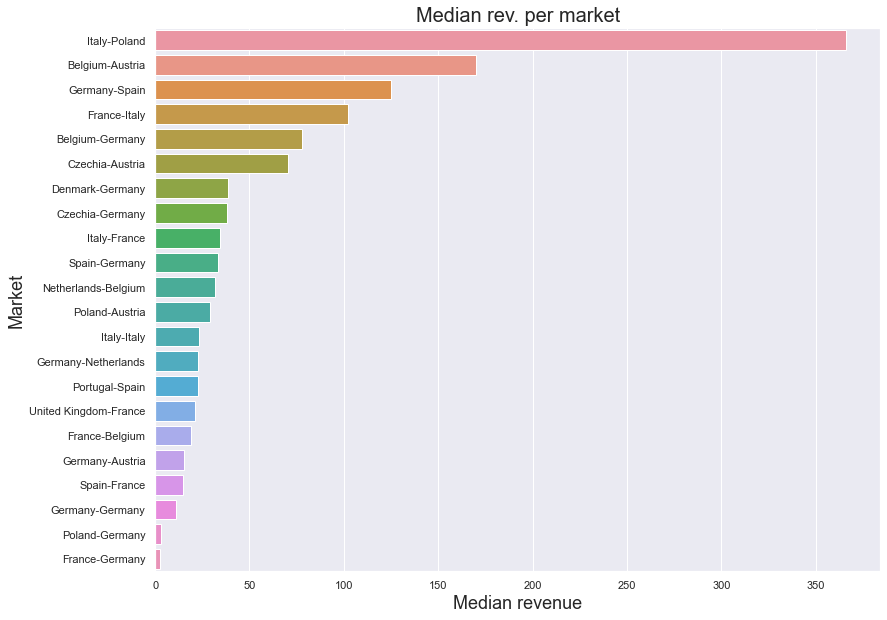

In [416]:
#Plot to see highes median rev markets
sns.set(rc={'figure.figsize':(13,10)})
sns.set_color_codes("pastel")
sns.barplot(x='median_revenue',
                 y='market',
                 data=just_revenue,
                 orient='h')
                 #palette='pastel')
plt.ylabel('Market', fontsize=18)
plt.xlabel('Median revenue', fontsize=18)
plt.title('Median rev. per market', fontsize=20)
plt.savefig('median_rev_market.png')

In [293]:
x = top_markets['market']
y=top_markets['%profit_margin']

fig = go.Figure(data=go.Scatter(x=x, y=y))
fig.update_xaxes(title_text='Market')
fig.update_yaxes(title_text='Profit margin')
fig.show()

In [266]:
difference = top_markets['revenue'].diff();

In [267]:
difference

17       NaN
23   -295.34
24     99.53
29    -67.69
32    -24.82
38    -46.00
44     -8.37
45    101.98
48    -87.24
49    -15.13
50     -4.01
51      3.86
53      6.24
54      9.64
57     -4.20
58    -13.05
59    -10.13
61      4.19
63     18.03
65    -18.80
68    -11.76
69      0.09
Name: revenue, dtype: float64

In [548]:
best_teams=pd.DataFrame(facts_merged.groupby(['market', 'team_name'])['revenue_total'].sum().sort_values(ascending=False).reset_index())

In [549]:
#Table with total rev values per team and market
best_teams

,market,team_name,revenue_total
0,Italy-Italy,Germany,94313.35
1,Germany-Germany,Italy,43681.65
2,Italy-Poland,France,6524.50
3,Italy-France,France,5646.99
4,Germany-Spain,France,4943.09
5,Spain-France,France,4835.67
6,Germany-Austria,Italy,4764.54
7,Germany-Spain,Germany,4479.36
8,Italy-France,Germany,4343.43
9,Italy-United Kingdom,France,4337.88


In [550]:
#Merge top_markets table with best teams
top_markets2=pd.merge(left=top_markets, right=best_teams, on='market', how='left')

In [564]:
top_markets2.sort_values(by=['median_revenue'],ascending=False)

,market,median_price,median_cost,median_revenue,profit_margin(%),quantity_orders,team_name,revenue_total
0,Italy-Poland,864.45,498.52,365.93,73.40,28,France,6524.50
2,Belgium-Austria,581.50,411.38,170.12,41.35,39,Italy,2371.27
15,Germany-Spain,1122.16,996.94,125.22,12.56,122,Germany,4479.36
16,Germany-Spain,1122.16,996.94,125.22,12.56,122,Italy,3973.75
14,Germany-Spain,1122.16,996.94,125.22,12.56,122,France,4943.09
5,France-Italy,399.98,297.55,102.43,34.42,22,Italy,-264.57
4,France-Italy,399.98,297.55,102.43,34.42,22,Germany,24.96
3,France-Italy,399.98,297.55,102.43,34.42,22,France,1624.66
7,Belgium-Germany,338.51,260.90,77.61,29.75,45,France,216.76
8,Belgium-Germany,338.51,260.90,77.61,29.75,45,Germany,131.47


In [ ]:
#Markets performance on routes w/ higher margin
profit_market=top_markets.iloc[0:9]
profit_market

Text(0.5, 1.0, 'Accountable party for cancellation')

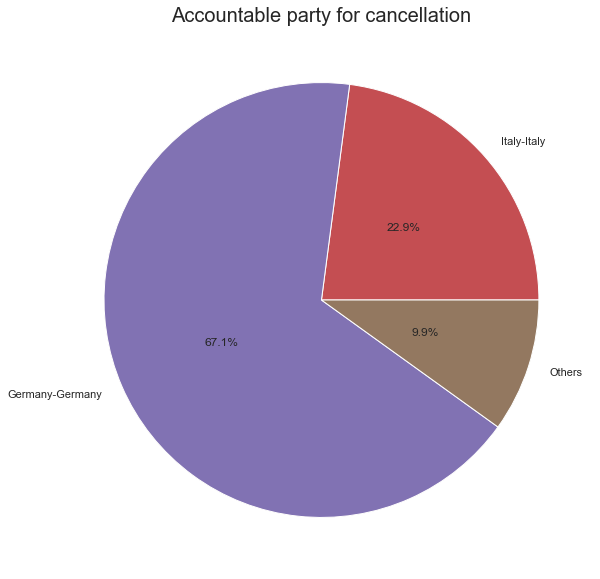

In [516]:
pie, ax = plt.subplots(figsize=[20,10])
labels = ['Italy-Italy','Germany-Germany', 'Others']
sizes= [2855,8361, 1236]
plt.pie(x=sizes, labels=labels)
plt.pie(x=sizes,autopct="%.1f%%", pctdistance=0.5)
plt.title("Accountable party for cancellation", fontsize=20)

In [555]:
#Most succesful teams in terms of volume
rev_team=top_markets2.iloc[[11, 34, 0, 29, 14, 42, 37, 15, 30, 17]]

In [556]:
rev_team

,market,median_price,median_cost,median_revenue,profit_margin(%),quantity_orders,team_name,revenue_total
11,Italy-Italy,202.07,178.83,23.24,13.00,2855,Germany,94313.35
34,Germany-Germany,232.20,221.00,11.20,5.07,8361,Italy,43681.65
0,Italy-Poland,864.45,498.52,365.93,73.40,28,France,6524.50
29,Italy-France,643.87,609.49,34.38,5.64,365,France,5646.99
14,Germany-Spain,1122.16,996.94,125.22,12.56,122,France,4943.09
42,Spain-France,617.31,602.69,14.62,2.43,113,France,4835.67
37,Germany-Austria,346.83,331.44,15.39,4.64,280,Italy,4764.54
15,Germany-Spain,1122.16,996.94,125.22,12.56,122,Germany,4479.36
30,Italy-France,643.87,609.49,34.38,5.64,365,Germany,4343.43
17,Czechia-Germany,393.94,355.96,37.98,10.67,85,Italy,4180.30


In [563]:
top_markets2.groupby(['market'])['revenue_total'].median().sort_values(ascending=False)

market
Italy-Poland             6524.500
Germany-Spain            4479.360
Italy-France             4343.430
Czechia-Germany          4180.300
Belgium-Austria          2371.270
Denmark-Germany          2298.690
Portugal-Spain           2142.460
Germany-Germany          1852.070
Czechia-Austria          1720.240
Spain-France             1473.125
Poland-Germany           1148.700
Poland-Austria           1033.785
Spain-Germany             929.935
Germany-Austria           842.670
Netherlands-Belgium       767.705
Belgium-Germany           216.760
France-Belgium             51.480
France-Italy               24.960
France-Germany           -244.290
Germany-Netherlands      -294.470
United Kingdom-France   -1268.720
Italy-Italy             -2374.070
Name: revenue_total, dtype: float64

In [218]:
#Team performance on routes w/ higher margin
profit_team=top_markets.iloc[0:9]
profit_team=profit_team.rename(columns={'revenue_y':'total_rev_per_team')

,market,median_price,median_cost,revenue_x,%profit_margin,quantity_orders,team_name,revenue_y
0,Italy-Poland,864.45,498.52,365.93,73.40,28,France,246.960
1,Czechia-Austria,235.79,165.20,70.59,42.73,28,Italy,172.665
2,Belgium-Austria,581.50,411.38,170.12,41.35,39,Italy,90.470
3,France-Italy,399.98,297.55,102.43,34.42,22,France,156.805
4,France-Italy,399.98,297.55,102.43,34.42,22,Germany,24.960
5,France-Italy,399.98,297.55,102.43,34.42,22,Italy,-264.570
6,Belgium-Germany,338.51,260.90,77.61,29.75,45,France,95.980
7,Belgium-Germany,338.51,260.90,77.61,29.75,45,Germany,38.330
8,Belgium-Germany,338.51,260.90,77.61,29.75,45,Italy,31.845


[None, None]

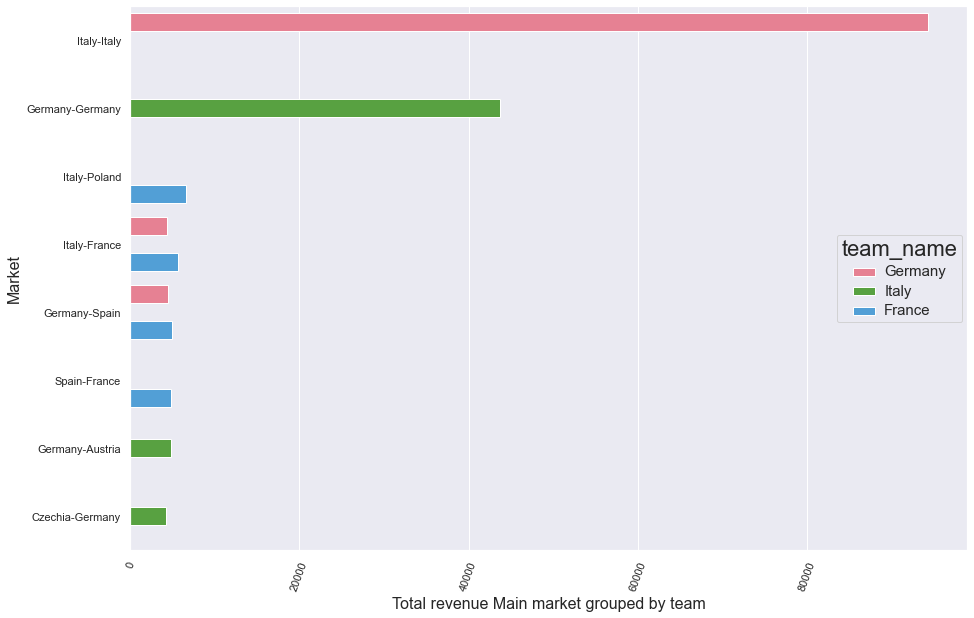

In [559]:
#Plot to show median revenue
ax=sns.barplot(x='revenue_total', y='market', hue='team_name', data=rev_team, palette='husl', orient='h')
plt.xlabel('Total revenue Main market grouped by team', fontsize=16)
plt.ylabel('Market', fontsize=16)
plt.xticks(rotation=70)
plt.setp(ax.get_legend().get_texts(), fontsize='15') # for legend text
plt.setp(ax.get_legend().get_title(), fontsize='22') # for legend title

In [560]:
top_markets2.groupby(['team_name'])['revenue_total'].sum()

team_name
France      24386.06
Germany    107948.29
Italy       55153.65
Poland        -83.86
Name: revenue_total, dtype: float64

In [454]:
top_markets2.groupby(['team_name'])['%profit_margin'].mean()

team_name
France     14.019375
Germany    11.298571
Italy      13.668947
Poland      9.680000
Name: %profit_margin, dtype: float64

In [ ]:
sns.set(font_scale=1.5)
sns.barplot(x='team_name', y='revenue', data=best_teams)
plt.xlabel('Teams', fontsize=25)
plt.ylabel('Revenue', fontsize=25)
plt.title('Revenue per team', fontsize=30)

In [ ]:
facts_merged[facts_merged['team_name'].isin(['Italy'])]

## Check cancellations

In [319]:
facts_merged2=pd.merge(left=facts, right=agents_teams, on='sales_agent_id', how='left')
facts_merged2=facts_merged2[facts_merged2['pickup_start_date'].isin(['2019, 8', '2019, 9', '2019, 10'])]

In [320]:
completed=facts_merged2[facts_merged2['order_is_cancelled'].isin([False])]

In [441]:
#Checking only cancellations
cancellations=facts_merged2[facts_merged2['order_is_cancelled'].isin([True])]
cancellations.head()

,order_id,order_is_cancelled,order_cancellation_accountable_party,order_cancellation_timestamp,order_base_cost,order_base_price,operator_id,sales_agent_id,carrier_salesforce_id,customer_salesforce_id,delivery_end_date,delivery_start_date,pickup_start_date,pickup_end_date,route_distance,origin_country_postal_code,destination_country_postal_code,origin_country,destination_country,sales_agent,team_id,id,team_name
19798,38617L,True,INTERNAL,2019-07-30,NaN,0.0,602.0,1869.0,NaN,0010O00001uqTXTQA2,2019-08-01,2019-08-01,2019-08-01,2019-08-01,223024.0,NL-5222 AP,FR-59370,Netherlands,France,Roberta Hollis,1.0,1.0,Germany
19808,42258BF,True,CARRIER,2019-09-11,NaN,0.0,1930.0,1448.0,NaN,0010O0000251kX8QAI,2019-09-02,2019-09-02,2019-09-01,2019-09-01,687826.0,FR-32730,FR-69970,France,France,NaN,NaN,NaN,NaN
19819,44232L,True,CUSTOMER,2019-07-30,NaN,0.0,1649.0,NaN,NaN,0013Y00002QU5WXQA1,2019-08-02,2019-08-02,2019-08-01,2019-08-01,327151.0,FR-76360,FR-10150,France,France,NaN,NaN,NaN,NaN
19934,45106A,True,CARRIER,2019-08-01,NaN,0.0,2322.0,277.0,0010O00001wKDk7QAG,0010O00002513hjQAA,2019-08-02,2019-08-02,2019-08-01,2019-08-01,751641.0,DE-40223,DE-83395,Germany,Germany,Kaci Beaumont,3.0,3.0,Italy
19939,45159D,True,CUSTOMER,2019-08-05,NaN,0.0,3105.0,1244.0,0010O00002AHCxCQAX,0010O00001s4o7hQAA,2019-08-01,2019-08-01,2019-08-01,2019-08-01,65919.0,FR-77610,FR-78140,France,France,Rickie Beard,3.0,3.0,Italy


In [323]:
#Nr. of orders acording to whom has cancelled them
reason=cancellations['order_cancellation_accountable_party'].value_counts()
reason

CUSTOMER    34
INTERNAL     9
CARRIER      7
Name: order_cancellation_accountable_party, dtype: int64

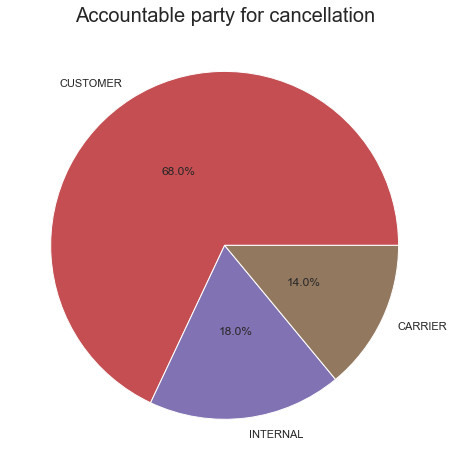

In [471]:
#Most orders are cancelled by Customers
pie, ax = plt.subplots(figsize=[15,8])
labels = reason.keys()
plt.pie(x=reason, labels=labels)
plt.pie(x=reason, autopct="%.1f%%", pctdistance=0.5)
plt.title("Accountable party for cancellation", fontsize=20);

In [443]:
#Code to convert date fileds from object to time series 
cancellations['order_cancellation_timestamp'] = pd.to_datetime(cancellations['order_cancellation_timestamp'], format="%Y/%m/%d %H:%M").dt.date
cancellations['delivery_start_date'] = pd.to_datetime(cancellations['delivery_start_date'], format="%d/%m/%Y %H:%M")
cancellations['delivery_end_date'] = pd.to_datetime(cancellations['delivery_end_date'], format="%d/%m/%Y")
cancellations['pickup_start_date'] = pd.to_datetime(cancellations['pickup_start_date'], format="%d/%m/%Y %H:%M")
cancellations['pickup_end_date'] = pd.to_datetime(cancellations['pickup_end_date'], format="%d/%m/%Y")


In [444]:
cancellations['order_cancellation_timestamp'] = pd.to_datetime(cancellations['order_cancellation_timestamp'], format='%Y/%m/%d')


In [445]:
#Create new variables:
#1-days from pick up to delivery
#2-days between delivery start date and cancellation
#cancellations['d_to_arrival']= cancellations['delivery_start_date']-cancellations['pickup_start_date']
#cancellations['d_to_arrival']= cancellations['d_to_arrival']/np.timedelta64(1,'D')
cancellations['diff_deliv_cancel']= cancellations['order_cancellation_timestamp']-cancellations['delivery_start_date']
cancellations['diff_deliv_cancel']= cancellations['diff_deliv_cancel']/np.timedelta64(1,'D')


In [446]:
cancellations.head()

,order_id,order_is_cancelled,order_cancellation_accountable_party,order_cancellation_timestamp,order_base_cost,order_base_price,operator_id,sales_agent_id,carrier_salesforce_id,customer_salesforce_id,delivery_end_date,delivery_start_date,pickup_start_date,pickup_end_date,route_distance,origin_country_postal_code,destination_country_postal_code,origin_country,destination_country,sales_agent,team_id,id,team_name,diff_deliv_cancel
19798,38617L,True,INTERNAL,2019-07-30,NaN,0.0,602.0,1869.0,NaN,0010O00001uqTXTQA2,2019-08-01,2019-08-01,2019-08-01,2019-08-01,223024.0,NL-5222 AP,FR-59370,Netherlands,France,Roberta Hollis,1.0,1.0,Germany,-2.0
19808,42258BF,True,CARRIER,2019-09-11,NaN,0.0,1930.0,1448.0,NaN,0010O0000251kX8QAI,2019-09-02,2019-09-02,2019-09-01,2019-09-01,687826.0,FR-32730,FR-69970,France,France,NaN,NaN,NaN,NaN,9.0
19819,44232L,True,CUSTOMER,2019-07-30,NaN,0.0,1649.0,NaN,NaN,0013Y00002QU5WXQA1,2019-08-02,2019-08-02,2019-08-01,2019-08-01,327151.0,FR-76360,FR-10150,France,France,NaN,NaN,NaN,NaN,-3.0
19934,45106A,True,CARRIER,2019-08-01,NaN,0.0,2322.0,277.0,0010O00001wKDk7QAG,0010O00002513hjQAA,2019-08-02,2019-08-02,2019-08-01,2019-08-01,751641.0,DE-40223,DE-83395,Germany,Germany,Kaci Beaumont,3.0,3.0,Italy,-1.0
19939,45159D,True,CUSTOMER,2019-08-05,NaN,0.0,3105.0,1244.0,0010O00002AHCxCQAX,0010O00001s4o7hQAA,2019-08-01,2019-08-01,2019-08-01,2019-08-01,65919.0,FR-77610,FR-78140,France,France,Rickie Beard,3.0,3.0,Italy,4.0


In [449]:
when_cancel=pd.DataFrame(cancellations.groupby(['order_cancellation_accountable_party','diff_deliv_cancel'])['order_id'].count().reset_index())
when_cancel.rename(columns={'diff_deliv_cancel':'days_before_after_delivery', 'order_id':'quantity_order'})

,order_cancellation_accountable_party,days_before_after_delivery,quantity_order
0,CARRIER,-7.0,1
1,CARRIER,-2.0,1
2,CARRIER,-1.0,2
3,CARRIER,0.0,1
4,CARRIER,5.0,1
5,CARRIER,9.0,1
6,CUSTOMER,-6.0,1
7,CUSTOMER,-5.0,1
8,CUSTOMER,-3.0,2
9,CUSTOMER,-2.0,4


In [ ]:
cancellations.groupby(['order_cancellation_accountable_party', 'd_to_arrival'])['d_to_arrival'].count()

In [344]:
#Check internal cancellations
internal=cancellations[cancellations['order_cancellation_accountable_party'].isin(['CUSTOMER'])]
print(internal.groupby(['origin_country', 'destination_country'])['order_is_cancelled'].count().sort_values(ascending=False))
print('-----------------')
cancellations.groupby(['origin_country', 'destination_country'])['order_is_cancelled'].count().sort_values(ascending=False)

origin_country  destination_country
Germany         Germany                9
France          France                 5
Germany         Belgium                4
Poland          Germany                3
Italy           Italy                  3
                Germany                2
Spain           Spain                  1
                France                 1
Poland          United Kingdom         1
Italy           France                 1
                Austria                1
Germany         France                 1
                Austria                1
France          Germany                1
Name: order_is_cancelled, dtype: int64
-----------------


origin_country  destination_country
Germany         Germany                18
France          France                  7
Germany         Belgium                 5
Spain           Spain                   3
Poland          Germany                 3
Italy           Italy                   3
Spain           France                  2
Italy           Germany                 2
Poland          United Kingdom          1
Netherlands     France                  1
Italy           France                  1
                Austria                 1
Germany         France                  1
                Austria                 1
France          Germany                 1
Name: order_is_cancelled, dtype: int64

In [345]:
#Cancellations per team
cancel_teams=cancellations.groupby(['team_name'])['order_is_cancelled'].count().sort_values(ascending=False)
cancel_teams

team_name
Italy      29
Germany    14
France      1
Name: order_is_cancelled, dtype: int64

In [346]:
#Total Orders per team
orders_teams=facts_merged2.groupby(['team_name'])['order_id'].count().sort_values(ascending=False)
orders_teams

team_name
Italy      521
Germany    215
France      50
Poland       6
Name: order_id, dtype: int64

In [347]:
#Completed Orders per team
completed_teams=completed.groupby(['team_name'])['order_id'].count().sort_values(ascending=False)
completed_teams

team_name
Italy      492
Germany    201
France      49
Poland       6
Name: order_id, dtype: int64

In [348]:
data={'team':['Italy','Germany','France', 'Poland'],'cancel_per_team':[616, 225, 43, 5], 'order_per_team':[7547, 2720, 758, 74], 'completed_per_team':[6931, 2495, 715, 69]}
cancel_data=pd.DataFrame(data, columns=['team', 'cancel_per_team', 'order_per_team', 'completed_per_team'])


In [349]:
cancel_data['%cancel']=round(cancel_data['cancel_per_team']/cancel_data['order_per_team']*100,2)

In [436]:
cancel_data=cancel_data.sort_values(by='%cancel',ascending=False)
cancel_data

,team,cancel_per_team,order_per_team,completed_per_team,%cancel
1,Germany,225,2720,2495,8.27
0,Italy,616,7547,6931,8.16
3,Poland,5,74,69,6.76
2,France,43,758,715,5.67


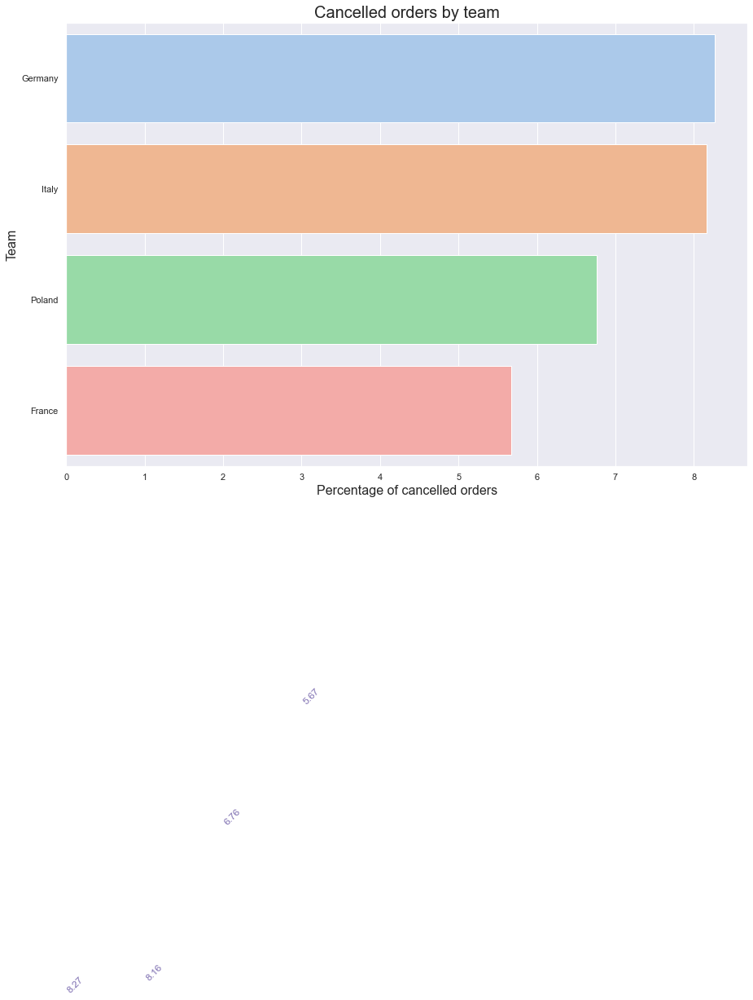

In [477]:
#Graph to show percentage of cancelled orders per team
sns.set(rc={'figure.figsize':(15,10)})
ax=sns.barplot(x='%cancel', y='team', data=cancel_data, orient='h', palette='pastel')
plt.title('Cancelled orders by team', fontsize='20')
plt.ylabel('Team', fontsize=16)
plt.xlabel('Percentage of cancelled orders', fontsize=16)
for i, v in enumerate(cancel_data["%cancel"].iteritems()):        
    ax.text(i ,v[1], "{:,}".format(v[1]), color='m', va ='bottom', rotation=45)
plt.show()

In [ ]:
proportion_cancel=round((cancel_teams/orders_teams)*100, 2)
proportion_cancel

## Challenge 3: Operators

In [127]:
#Drop na for operators table
operators=operators.dropna()
operators

,operator_id,account_manager_name
1,2.0,Domas Daniels
3,163.0,Hendrix Paul
5,171.0,Autumn Edge
7,177.0,Mack Nieves
9,277.0,Freddy Duncan
11,278.0,Mahi Whittle
13,340.0,Bryan Hughes
15,376.0,Mattie Sampson
17,391.0,Mahira Acosta
19,420.0,Ronny Wang


In [128]:
#Merge facts with operators
facts_operators=pd.merge(left=facts, right=operators, on='operator_id', how='left')


In [ ]:
facts_operators

In [129]:
facts_operators['month']=pd.DatetimeIndex(facts_operators['delivery_end_date']).month
#df['year'] = pd.DatetimeIndex(df['birth_date']).year

In [130]:
facts_operators=facts_operators[facts_operators['month'].isin([8,9,10])]


In [122]:
#facts_operators=pd.merge(left=facts_operators, right=carriers, on='carrier_salesforce_id', how='left')

In [ ]:
facts_operators

In [132]:
top_10=best_operators.iloc[:10]
top_10=top_10.reset_index()


In [134]:
#Focus on non cancelled orders
boolean_filter7=facts_operators['order_is_cancelled'].isin([False])
without_cancel=facts_operators[boolean_filter7]
without_cancel

,order_id,order_is_cancelled,order_cancellation_accountable_party,order_cancellation_timestamp,order_base_cost,order_base_price,operator_id,sales_agent_id,carrier_salesforce_id,customer_salesforce_id,delivery_end_date,delivery_start_date,pickup_start_date,pickup_end_date,route_distance,origin_country_postal_code,destination_country_postal_code,origin_country,destination_country,account_manager_name,month
0,1831B,False,NaN,NaT,535.81,748.97,602.0,1448.0,0010O00002C8QA3QAN,0010O00001t5UnpQAE,2019-10-09,2019-10-09,2019-10-08,2019-10-08,944425.0,FR-59125,DE-03042,France,Germany,Idrees Frye,10
1,1831C,False,NaN,NaT,422.41,601.31,602.0,1448.0,0010O00002C8QA3QAN,0010O00001t5UnpQAE,2019-10-09,2019-10-09,2019-10-08,2019-10-08,944425.0,FR-59125,DE-03042,France,Germany,Idrees Frye,10
2,20150B,False,NaN,NaT,7.88,19.00,3691.0,1448.0,0010O00002E9hNNQAZ,0010O000027qh02QAA,2019-10-09,2019-10-09,2019-10-08,2019-10-08,237449.0,FR-38070,FR-84320,France,France,Lilia Vasquez,10
3,26626B,False,NaN,NaT,20.28,380.07,1649.0,1448.0,0010O00002C8QA3QAN,0010O00001t5UnpQAE,2019-09-23,2019-09-23,2019-09-20,2019-09-20,464857.0,FR-59125,DE-33647,France,Germany,Fallon Parrish,9
4,28121G,False,NaN,NaT,896.96,319.02,340.0,1244.0,0010O00001s56d9QAA,0010O00001s4o7hQAA,2019-08-22,2019-08-22,2019-08-21,2019-08-21,0.0,PL-71-001,PL-71-001,Poland,Poland,Bryan Hughes,8
5,28121H,False,NaN,NaT,3330.20,2123.25,340.0,1244.0,0010O00001s56d9QAA,0010O00001s4o7hQAA,2019-08-23,2019-08-23,2019-08-22,2019-08-22,0.0,PL-71-001,PL-71-001,Poland,Poland,Bryan Hughes,8
6,28121I,False,NaN,NaT,1877.99,1354.45,340.0,1244.0,0010O00001s56d9QAA,0010O00001s4o7hQAA,2019-09-30,2019-09-30,2019-09-01,2019-09-01,0.0,PL-71-001,PL-71-001,Poland,Poland,Bryan Hughes,9
7,28139B,False,NaN,NaT,360.79,264.82,1649.0,1448.0,0010O00002C8QA3QAN,0010O00001t5UnpQAE,2019-09-05,2019-09-05,2019-09-04,2019-09-04,526271.0,FR-59125,DE-34260,France,Germany,Fallon Parrish,9
8,28139C,False,NaN,NaT,104.85,270.17,1649.0,1448.0,0010O00001vmhtrQAA,0010O00001t5UnpQAE,2019-09-05,2019-09-05,2019-09-04,2019-09-04,526271.0,FR-59125,DE-34260,France,Germany,Fallon Parrish,9
9,28139D,False,NaN,NaT,171.94,401.34,1649.0,1448.0,0010O000022kGatQAE,0010O00001t5UnpQAE,2019-09-05,2019-09-05,2019-09-04,2019-09-04,526271.0,FR-59125,DE-34260,France,Germany,Fallon Parrish,9


In [135]:
#See which operators have done the biggest count of orders
best_operators_2=pd.DataFrame(without_cancel.groupby(['account_manager_name'])['order_id'].count().sort_values(ascending=False))
best_operators_2

,order_id
account_manager_name,
Saira Dale,1852
Blanche Mclean,1685
Rebekah Flowers,858
Aj Alexander,775
Bryan Hughes,765
Gabriela Bradford,735
Harper-Rose Roy,595
Ozan Roberts,521
Juanita Duffy,446


In [136]:
#Check the top10 operators according to the number of orders, without the cancelled orders
top_10_2=best_operators.iloc[:10]
top_10_2=top_10.reset_index()

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 <a list of 10 Text major ticklabel objects>)

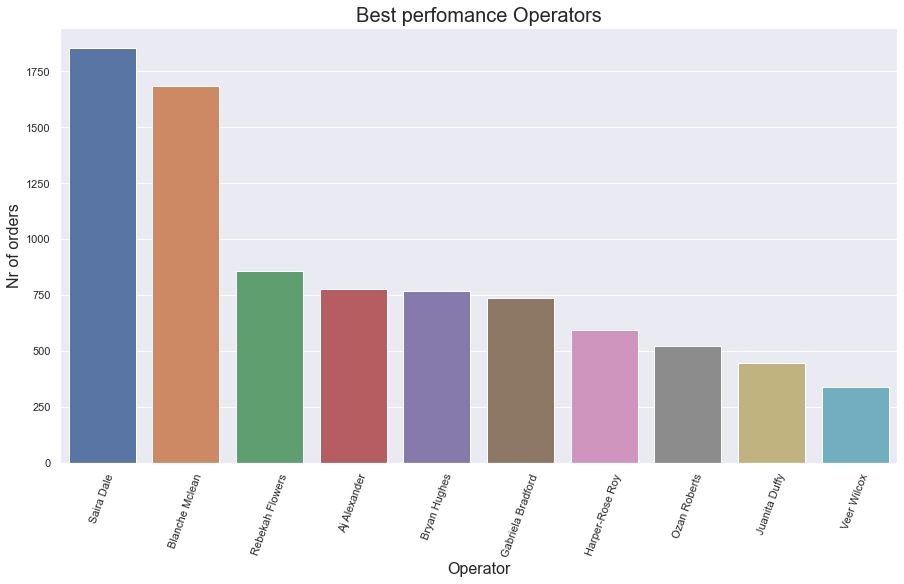

In [458]:
#Top 10 operators (without cancelled orders)
sns.set(rc={'figure.figsize':(15,8)})
sns.barplot(x="account_manager_name", y="order_id", data=top_10_2)
plt.title('Best perfomance Operators', fontsize='20')
plt.ylabel('Nr of orders', fontsize=16)
plt.xlabel('Operator', fontsize=16)
plt.xticks(rotation=70)

In [145]:
monthly_perf_10_2=pd.read_excel(r'C:\Users\nwuser\Documents\Data Analytics\monthly_perf2.xlsx')
monthly_perf_10_2

,account_manager_name,month,order_id,Unnamed: 3
0,Aj Alexander,Aug,99,NaN
1,Aj Alexander,Sep,353,72.0
2,Aj Alexander,Oct,32,-1003.1
3,Blanche Mclean,Aug,549,NaN
4,Blanche Mclean,Sep,485,-13.2
5,Blanche Mclean,Oct,64,-657.8
6,Bryan Hughes,Aug,427,NaN
7,Bryan Hughes,Sep,49,-771.4
8,Bryan Hughes,Oct,29,-69.0
9,Gabriela Bradford,Aug,1,NaN


In [399]:
group1=monthly_perf_10_2[monthly_perf_10_2['account_manager_name'].isin(['Saira Dale', 'Blanche Mclean'])]
group2=monthly_perf_10_2[monthly_perf_10_2['account_manager_name'].isin(['Rebekah Flowers', 'Gabriela Bradford', 'Aj Alexander'])]
group3=monthly_perf_10_2[monthly_perf_10_2['account_manager_name'].isin(['Veer Wilcox', 'Ozan Roberts', 'Harper-Rose Roy','Bryan Hughes'])]


[(0.0, 600.0)]

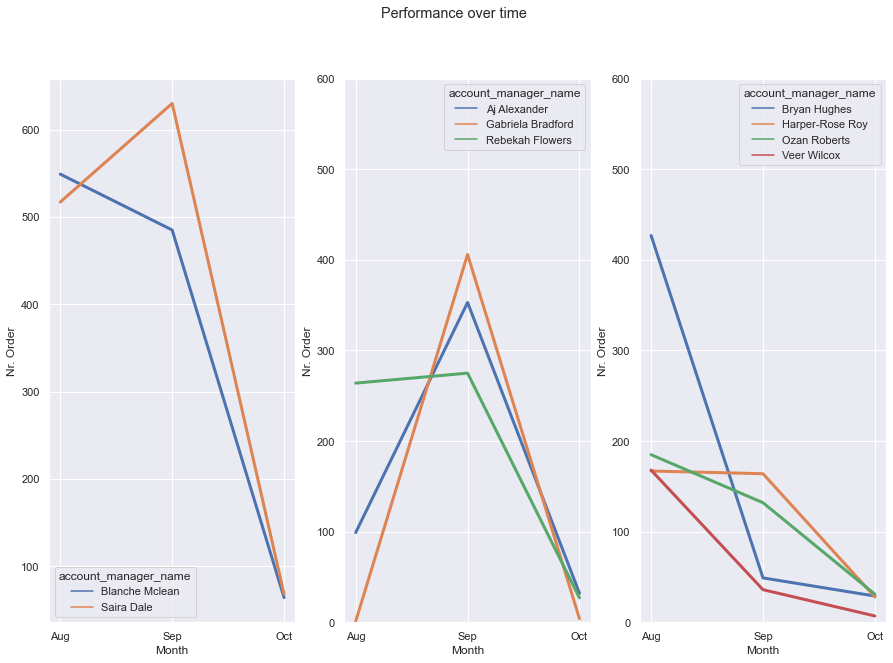

In [457]:
#Show evolution over time for transports handled by each operator
fig, axes = plt.subplots(1, 3)  #Define fig: subplot format (1 row, 3 columns)
fig.suptitle('Performance over time') #Add title to fig 


for ax in axes.flat:
    ax.set(xlabel='Month', ylabel='Nr. Order')  #for loop to ticks lables

#Divided top10 operators according to pattern observed
ax1=sns.lineplot(ax=axes[0],x="month", y="order_id", hue="account_manager_name", data=group1, linewidth=3)
ax2=sns.lineplot(ax=axes[1],x="month", y="order_id", hue="account_manager_name", data=group2, linewidth=3)
ax3=sns.lineplot(ax=axes[2],x="month", y="order_id", hue="account_manager_name", data=group3, linewidth=3)
ax2.set(ylim=(0, 600))
ax3.set(ylim=(0, 600))

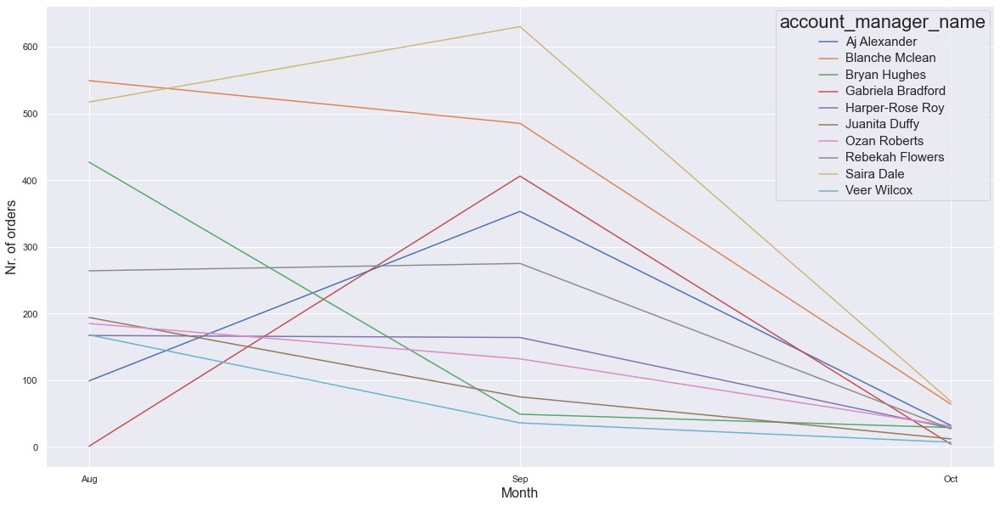

In [146]:
ax=sns.lineplot(x="month", y="order_id", hue="account_manager_name", data=monthly_perf_10_2)
plt.xlabel('Month', fontsize=16)
plt.ylabel('Nr. of orders', fontsize=16)
plt.setp(ax.get_legend().get_texts(), fontsize='15') # for legend text
plt.setp(ax.get_legend().get_title(), fontsize='22') # for legend title



plt.show()

In [ ]:
# Initialize the figure
plt.style.use('seaborn-darkgrid')
# create a color palette
palette = plt.get_cmap('Set1')

In [ ]:
facts_operators.to_excel('facts_operators.xlsx')

## Challenge 4

In [354]:
customers.dropna()

,customer_salesforce_id,customer_name
1,0010O00001s4Ca2QAE,Electron Systems
3,0010O00001s4CbbQAE,Freak Aviation
5,0010O00001s4CbRQAU,Ghost Security
7,0010O00001s4Cc4QAE,Energy Acoustics
9,0010O00001s4CcDQAU,Paragon Lighting
11,0010O00001s4CcFQAU,Timber Brews
13,0010O00001s4CcGQAU,Rush Microsystems
15,0010O00001s4CcHQAU,Vision Arts
17,0010O00001s4CcJQAU,Nimble Electronics
19,0010O00001s4Cg9QAE,Vortex Networks


In [355]:
sales_agents

,sales_agent_id,sales_agent,team_id
0,NaN,NaN,NaN
1,2.0,Piper Finnegan,1.0
2,NaN,NaN,NaN
3,42.0,Caine Gutierrez,1.0
4,NaN,NaN,NaN
5,109.0,Ameer Atkinson,1.0
6,NaN,NaN,NaN
7,163.0,Annika Haines,4.0
8,NaN,NaN,NaN
9,277.0,Kaci Beaumont,3.0


In [356]:
#Merge facts table with customer data
facts_customer=pd.merge(left=facts, right=customers, on='customer_salesforce_id', how='left')


In [357]:
#Merge customer data with sales agents
facts_customer=pd.merge(left=facts_customer, right=sales_agents, on='sales_agent_id', how='left')

In [358]:
#Add month data
facts_customer['month']=pd.DatetimeIndex(facts_customer['pickup_start_date']).month

In [359]:
#Remove cancelled orders
boolean6=facts_customer['order_is_cancelled'].isin([False])
facts_customer=facts_customer[boolean6]



In [360]:
#Calculate Revenue
facts_customer['revenue']=facts_customer['order_base_price']-facts_customer['order_base_cost']

In [361]:
#Calculate avg revenue per customer per month
NBR=pd.DataFrame(round(facts_customer.groupby(['customer_name','month'])['revenue'].mean(),2).reset_index())
NBR

,customer_name,month,revenue
0,Ace tronics,7,-223.12
1,Ace tronics,8,-249.25
2,Ace tronics,9,-34.13
3,Ace tronics,10,-551.25
4,Aces,8,-209.11
5,Aces,9,152.05
6,Aces,10,-160.22
7,Alpine Foods,7,19.40
8,Alpine Foods,8,-41.20
9,Alpine Foods,9,-60.79


In [ ]:
#Save result into an excel file
NBR.to_excel('NBR.xlsx')

In [ ]:
##Next steps are to gather which customers had orders on all four months(Aug-Oct)

In [362]:
#Group by customer and check for duplicates months in the results and drops them
tmp=facts_customer.groupby(['customer_name'])['month'].apply(lambda x: x.drop_duplicates())

In [363]:
#Below one can see in which month each customer had an order
tmp

customer_name                
Ace tronics             2205      7
                        7669      8
                        17081     9
                        28864    10
Aces                    5774      8
                        11879     9
                        27614    10
Alpine Foods            1076      7
                        5015      8
                        9122      9
                        27682    10
Alpite                  2445      7
                        4205      8
                        14517     9
Amazon walk             28477     9
                        29478    10
Amazon world            29592    10
                        29593     9
Amazystems              2402      7
                        3537      8
                        16333     9
                        28424    10
Answer Sports           2600      7
                        5486      8
                        14957     9
                        28694    10
Antarts                 142       

In [364]:
#Retrieve only thos customers that had orders in all four months
total = tmp.groupby(level=0).count()
total = total[total == 4]

In [96]:
total2 = tmp.groupby(level=0).count()
total2 = total2[total2 == 3]

In [365]:
#Create tabke with only those customers that had orders in all four months
four_months=facts_customer[facts_customer['customer_name'].isin(total.index)]


In [366]:
#Avg. revenue for customer from the above table
new_rev4=pd.DataFrame(round(four_months.groupby(['customer_name', 'month'])['revenue'].mean(),2).reset_index())
new_rev4

,customer_name,month,revenue
0,Ace tronics,7,-223.12
1,Ace tronics,8,-249.25
2,Ace tronics,9,-34.13
3,Ace tronics,10,-551.25
4,Alpine Foods,7,19.40
5,Alpine Foods,8,-41.20
6,Alpine Foods,9,-60.79
7,Alpine Foods,10,-71.77
8,Amazystems,7,-72.77
9,Amazystems,8,-105.38


In [382]:
nbr_agents=four_months[four_months['customer_name'].isin(['Cyclolutions','Hookurity','Hammertronics','Ask Foods','Crystalightning GmbH','Dreamedia','Explority','Hog Co.','Signetworks','Vertexoftwards','Willowares'])] 
nbr_agents=nbr_agents[nbr_agents['month'].isin([8,9,10])]



In [387]:
nbr_agents.sort_values(by='customer_name', ascending=True)

,order_id,order_is_cancelled,order_cancellation_accountable_party,order_cancellation_timestamp,order_base_cost,order_base_price,operator_id,sales_agent_id,carrier_salesforce_id,customer_salesforce_id,delivery_end_date,delivery_start_date,pickup_start_date,pickup_end_date,route_distance,origin_country_postal_code,destination_country_postal_code,origin_country,destination_country,customer_name,sales_agent,team_id,month,revenue
25986,52691A,False,NaN,NaT,481.48,379.92,2323.0,2318.0,0010O00002E7aigQAB,0010O000027puAcQAI,2019-09-24,2019-09-24,2019-09-23,2019-09-23,432610.0,DE-70329,DE-47119,Germany,Germany,Ask Foods,Rupert Townsend,1.0,9,-101.56
12270,48764C,False,NaN,NaT,189.68,1.22,2323.0,2318.0,0010O00002E7aigQAB,0010O000027puAcQAI,2019-08-29,2019-08-29,2019-08-28,2019-08-28,432588.0,DE-70329,DE-47119,Germany,Germany,Ask Foods,Rupert Townsend,1.0,8,-188.46
12269,48764B,False,NaN,NaT,254.55,487.40,2323.0,2318.0,0010O00002E7aigQAB,0010O000027puAcQAI,2019-08-28,2019-08-28,2019-08-27,2019-08-27,432588.0,DE-70329,DE-47119,Germany,Germany,Ask Foods,Rupert Townsend,1.0,8,232.85
12268,48764A,False,NaN,NaT,264.05,7.52,2323.0,2318.0,0010O00002E7aigQAB,0010O000027puAcQAI,2019-08-27,2019-08-27,2019-08-26,2019-08-26,432588.0,DE-70329,DE-47119,Germany,Germany,Ask Foods,Rupert Townsend,1.0,8,-256.53
10388,48082C,False,NaN,NaT,461.12,61.67,2323.0,2318.0,0010O00002E7aigQAB,0010O000027puAcQAI,2019-08-21,2019-08-21,2019-08-21,2019-08-21,432586.0,DE-70329,DE-47119,Germany,Germany,Ask Foods,Rupert Townsend,1.0,8,-399.45
10387,48082B,False,NaN,NaT,182.81,192.01,2323.0,2318.0,0010O00002E7aigQAB,0010O000027puAcQAI,2019-08-21,2019-08-21,2019-08-20,2019-08-20,432586.0,DE-70329,DE-47119,Germany,Germany,Ask Foods,Rupert Townsend,1.0,8,9.20
10386,48082A,False,NaN,NaT,356.21,401.76,2323.0,2318.0,0010O00002E7aigQAB,0010O000027puAcQAI,2019-08-20,2019-08-20,2019-08-19,2019-08-19,432586.0,DE-70329,DE-47119,Germany,Germany,Ask Foods,Rupert Townsend,1.0,8,45.55
20013,50826A,False,NaN,NaT,264.04,531.63,2323.0,2318.0,0010O00002E7aigQAB,0010O000027puAcQAI,2019-09-12,2019-09-12,2019-09-11,2019-09-11,432610.0,DE-70329,DE-47119,Germany,Germany,Ask Foods,Rupert Townsend,1.0,9,267.59
25987,52691B,False,NaN,NaT,152.65,69.51,2323.0,2318.0,0010O00002E7aigQAB,0010O000027puAcQAI,2019-09-30,2019-09-30,2019-09-27,2019-09-27,432610.0,DE-70329,DE-47119,Germany,Germany,Ask Foods,Rupert Townsend,1.0,9,-83.14
25988,52691C,False,NaN,NaT,151.53,78.30,2323.0,2318.0,0010O00002E7aigQAB,0010O000027puAcQAI,2019-09-26,2019-09-26,2019-09-25,2019-09-25,432610.0,DE-70329,DE-47119,Germany,Germany,Ask Foods,Rupert Townsend,1.0,9,-73.23


In [408]:
agents=pd.DataFrame(nbr_agents.groupby(['sales_agent', 'customer_name'])['order_id'].count().sort_values(ascending=False).reset_index())

In [414]:
agents=agents.sort_values(by=['sales_agent','order_id'], ascending=False)

In [415]:
agents.to_excel('agents.xlsx')